# Rt profile multicategorical versus uniform

In [1]:
# Import libraries
import numpy as np
import math
import branchpro
import scipy.stats
from branchpro.apps import ReproductionNumberPlot
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import pandas as pd
from cmdstanpy import CmdStanModel, cmdstan_path
import arviz as az
import nest_asyncio
import seaborn as sns
nest_asyncio.apply()

num_timepoints = 100 # number of days for incidence data
num_categories = 2

/Users/ioaros/opt/anaconda3/envs/testbranchpro2/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
# # Read contact matrix
# cm_file = 'UK'
# path = os.path.join('../data_library/contact_matrix', '{}.csv'.format(cm_file))
# contact_matrix = pd.read_csv(path, header=None)

# # Read serial interval
# si_file = 'si-epinow'
# path = os.path.join('../data_library/serial_interval', '{}.csv'.format(si_file))
# serial_interval = pd.read_csv(path, header=None)
# serial_interval = serial_interval.fillna(0)
# serial_intervals = serial_interval.values.T

# # Read transmissibility vector
# trans_file = 'UK'
# path = os.path.join('../data_library/transmissibility', '{}.csv'.format(trans_file))
# transmissibility = pd.read_csv(path, header=None)

In [3]:
# # Read Ontario data
# path = os.path.join('../data_library/covid_ontario/ON.csv')
# data = pd.read_csv(path)[:51]

## Parameterize example branching process model with disagregated data

In [4]:
# Build the serial interval w_s
ws_mean = 15.3
ws_var = 9.3**2
theta = ws_var / ws_mean
k = ws_mean / theta
w_dist = scipy.stats.gamma(k, scale=theta)
disc_w = w_dist.pdf(np.arange(num_timepoints))

# Simulate incidence data
initial_r = 1.2
serial_interval = disc_w

# contact_matrix = contact_matrix
contact_matrix = np.array([[8., 4.8], [1.2, 3.84]])
# contact_matrix = 1 * np.ones((2, 2))

transmissibility = [1, 0.5]
# transmissibility = [1.5, 1.5]

m = branchpro.MultiCatPoissonBranchProModel(
    initial_r, serial_interval, num_categories, contact_matrix, transmissibility)
new_rs = [0.5, 0.05, 0.2]          # sequence of R_0 numbers
start_times = [0, 30, 60]      # days at which each R_0 period begins
m.set_r_profile(new_rs, start_times)
parameters = [200, 20] # initial number of cases
times = np.arange(num_timepoints)

desagg_cases = m.simulate(parameters, times, var_contacts=True)
agg_cases = np.sum(desagg_cases, axis=1)

print(desagg_cases)

[[200.  20.]
 [  0.   0.]
 [  6.   0.]
 [ 13.   0.]
 [ 18.   4.]
 [ 35.   0.]
 [ 31.   6.]
 [ 40.   4.]
 [ 42.  17.]
 [ 25.   0.]
 [ 98.   6.]
 [ 39.   8.]
 [ 89.  13.]
 [ 76.  23.]
 [ 70.  31.]
 [126.  14.]
 [114.  14.]
 [201.   0.]
 [ 61.  20.]
 [157.  63.]
 [161.  31.]
 [239.  52.]
 [136.  32.]
 [111.  57.]
 [238.  46.]
 [453.  42.]
 [274.  26.]
 [456.  97.]
 [570. 120.]
 [384. 128.]
 [676. 129.]
 [ 54.   7.]
 [ 45.  14.]
 [ 51.  16.]
 [ 67.   6.]
 [ 81.  12.]
 [ 15.  49.]
 [ 54.  31.]
 [ 49.   7.]
 [ 58.  11.]
 [112.  23.]
 [119.  21.]
 [ 31.   2.]
 [ 74.   1.]
 [ 76.  22.]
 [ 92.  26.]
 [ 75.  25.]
 [ 62.  14.]
 [ 64.   3.]
 [ 64.   9.]
 [ 85.  20.]
 [ 26.   1.]
 [ 48.   4.]
 [ 54.  10.]
 [ 69.  11.]
 [ 49.   1.]
 [ 16.   0.]
 [ 45.  10.]
 [ 30.   9.]
 [ 44.  19.]
 [ 22.   1.]
 [166.  18.]
 [173.  21.]
 [ 85.  44.]
 [ 94.   8.]
 [ 68.  16.]
 [ 65.  16.]
 [136.   0.]
 [ 55.  16.]
 [122.  17.]
 [ 99.  35.]
 [129.  72.]
 [115.  32.]
 [145.  15.]
 [109.  21.]
 [147.   7.]
 [179.  33.]

## Plot agreggated local incidence numbers

In [5]:
# Plot (bar chart cases each day)
fig = go.Figure()

# Plot of incidences
fig.add_trace(
    go.Bar(
        x=times,
        y=agg_cases,
        name='Incidences'
    )
)

# Add axis labels
fig.update_layout(
    xaxis_title='Time (days)',
    yaxis_title='New cases'
)

fig.show()

## R_t inference using STAN

In [6]:
# Same inference, but using the PoissonBranchProPosterior
tau = 6
R_t_start = tau+1
a = 1
b = 1/5
sigma = 1.5

# Correction for reproduction number per category
correc_i = np.multiply(np.sum(contact_matrix, axis=0), transmissibility)
correc_e = np.multiply(np.sum(m.exact_contact_matrix, axis=1), transmissibility)

In [7]:
# Transform our incidence data into pandas dataframes
multicat_inc_data_matrix = {'Time': np.arange(num_timepoints)}

for _ in range(num_categories):
    multicat_inc_data_matrix['Incidence Number Cat {}'.format(_+1)] = \
        desagg_cases[:, _]

multicat_inc_data = pd.DataFrame(multicat_inc_data_matrix)

# Transform our incidence data into pandas dataframes
inc_data = pd.DataFrame(
    {
        'Time': np.arange(num_timepoints),
        'Incidence Number': agg_cases
    }
)

L1 = len(np.arange(R_t_start, start_times[1]+1))
L2 = len(np.arange(start_times[1]+1, start_times[2]+1))
L3 = len(np.arange(start_times[2]+1, num_timepoints))

ground_truth = []
for j in range(num_categories):
    ground_truth.append(pd.DataFrame({
        'Time Points': np.arange(R_t_start, num_timepoints),
        'R_t': (0.5*correc_e[R_t_start:(start_times[1]+1), j]).tolist() + (0.05*correc_e[(start_times[1]+1):(start_times[2]+1), j]).tolist() + (0.2*correc_e[(start_times[2]+1):num_timepoints, j]).tolist()
    }))

## 1. Perfect Contact Tracing + Desaggregated data + Poisson Branching process with multiple categories

In [8]:
exact_multicat_model = CmdStanModel(stan_file=os.path.join(
        '../../stan_models/exact_multicat.stan'))

exact_multicat_data = {
    'N': num_timepoints,
    'S': len(serial_interval),
    'n': num_categories,
    'C': np.array(m.exact_contact_matrix),
    'transm': transmissibility,
    'I': desagg_cases.astype(np.integer).tolist(),
    'tau': tau,
    'revSI': serial_interval.tolist()[::-1],
    'a': a,
    'b': b,
    'sigma': sigma}

/var/folders/ph/jyxnc9y52svgq2k5lt2q4r000000gp/T/ipykernel_1789/3829575306.py:10: DeprecationWarning:

Converting `np.integer` or `np.signedinteger` to a dtype is deprecated. The current result is `np.dtype(np.int_)` which is not strictly correct. Note that the result depends on the system. To ensure stable results use may want to use `np.int64` or `np.int32`.



In [9]:
fit = exact_multicat_model.sample(
    data=exact_multicat_data, seed=10, chains=3, iter_sampling=1000)

samples = az.from_cmdstanpy(fit)

az.summary(samples)

10:39:44 - cmdstanpy - INFO - CmdStan start processing
chain 1 |          | 00:00 Status

chain 1 |▍         | 00:00 Status
chain 1 |▉         | 01:05 Iteration:    1 / 2000 [  0%]  (Warmup)
chain 1 |█▎        | 01:54 Iteration:  100 / 2000 [  5%]  (Warmup)
chain 1 |██▎       | 03:18 Iteration:  300 / 2000 [ 15%]  (Warmup)

chain 1 |██▋       | 04:03 Iteration:  400 / 2000 [ 20%]  (Warmup)
chain 1 |███▏      | 04:45 Iteration:  500 / 2000 [ 25%]  (Warmup)
chain 1 |███▋      | 05:28 Iteration:  600 / 2000 [ 30%]  (Warmup)
chain 1 |████      | 06:08 Iteration:  700 / 2000 [ 35%]  (Warmup)
chain 1 |████▌     | 06:42 Iteration:  800 / 2000 [ 40%]  (Warmup)

chain 1 |█████▉    | 07:51 Iteration: 1001 / 2000 [ 50%]  (Sampling)
chain 1 |██████▎   | 08:23 Iteration: 1100 / 2000 [ 55%]  (Sampling)
chain 1 |██████▊   | 08:54 Iteration: 1200 / 2000 [ 60%]  (Sampling)
chain 1 |███████▎  | 09:25 Iteration: 1300 / 2000 [ 65%]  (Sampling)
chain 1 |████████▏ | 10:28 Iteration: 1500 / 2000 [ 75%]  (Sam


10:53:48 - cmdstanpy - INFO - CmdStan done processing.
10:53:48 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'exact_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'exact_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'exact_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'exact_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'exact_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'exact_multicat.stan', line 55, column 8 to column 28)
Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
R[0],0.449,0.036,0.385,0.519,0.001,0.0,4071.0,2248.0,1.00
R[1],0.451,0.030,0.397,0.510,0.000,0.0,3763.0,2209.0,1.00
R[2],0.427,0.028,0.375,0.480,0.000,0.0,4257.0,2359.0,1.00
R[3],0.433,0.024,0.390,0.479,0.000,0.0,3724.0,2020.0,1.00
R[4],0.439,0.023,0.399,0.485,0.000,0.0,4018.0,2002.0,1.00
...,...,...,...,...,...,...,...,...,...
R[88],0.198,0.004,0.191,0.207,0.000,0.0,4344.0,2520.0,1.00
R[89],0.202,0.005,0.194,0.211,0.000,0.0,4137.0,2203.0,1.00
R[90],0.205,0.004,0.198,0.213,0.000,0.0,3954.0,2210.0,1.00
R[91],0.200,0.004,0.192,0.208,0.000,0.0,4124.0,2039.0,1.00


array([[<Axes: title={'center': 'R\n0'}>,
        <Axes: title={'center': 'R\n0'}>],
       [<Axes: title={'center': 'R\n1'}>,
        <Axes: title={'center': 'R\n1'}>],
       [<Axes: title={'center': 'R\n2'}>,
        <Axes: title={'center': 'R\n2'}>],
       [<Axes: title={'center': 'R\n3'}>,
        <Axes: title={'center': 'R\n3'}>],
       [<Axes: title={'center': 'R\n4'}>,
        <Axes: title={'center': 'R\n4'}>],
       [<Axes: title={'center': 'R\n5'}>,
        <Axes: title={'center': 'R\n5'}>],
       [<Axes: title={'center': 'R\n6'}>,
        <Axes: title={'center': 'R\n6'}>],
       [<Axes: title={'center': 'R\n7'}>,
        <Axes: title={'center': 'R\n7'}>],
       [<Axes: title={'center': 'R\n8'}>,
        <Axes: title={'center': 'R\n8'}>],
       [<Axes: title={'center': 'R\n9'}>,
        <Axes: title={'center': 'R\n9'}>],
       [<Axes: title={'center': 'R\n10'}>,
        <Axes: title={'center': 'R\n10'}>],
       [<Axes: title={'center': 'R\n11'}>,
        <Axes: title

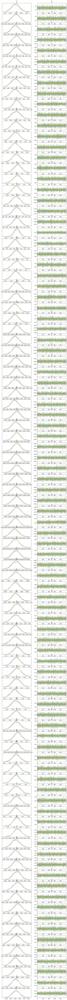

In [10]:
az.rcParams['plot.max_subplots'] = 2*(num_timepoints - R_t_start)

az.plot_trace(
    samples,
    var_names=('R'),
    filter_vars='like',
    compact=False)

In [11]:
# Eliminate burn-in iterations (1/2 of the chain lengths)
chain_samples = fit.draws()[500:, :, 7:]

# Evaluate the model for all parameter sets in the samples
n_param, n_sample, n_chains = chain_samples.shape

extended_samples = np.concatenate((
    chain_samples[:, 0, :],
    chain_samples[:, 1, :],
    chain_samples[:, 2, :]), axis=0)

thinning = max(1, int(n_sample * n_chains / 500))
exact_multicat_intervals = []

for j in range(num_categories):
    exact_multicat_intervals.append(pd.DataFrame({
        'Time Points': np.arange(R_t_start, num_timepoints),
        'Mean': np.mean(extended_samples[::thinning, :] * correc_e[R_t_start:, j][None, :], axis=0),
        'Lower bound CI': np.quantile(extended_samples[::thinning, :] * correc_e[R_t_start:, j][None, :], 0.025, axis=0),
        'Upper bound CI': np.quantile(extended_samples[::thinning, :] * correc_e[R_t_start:, j][None, :], 0.975, axis=0),
        'Central Probability': (L1+L2+L3) * [0.95]
    }))

## 2. Imperfect Contact Tracing + Desaggregated data + Poisson Branching process with multiple categories

In [12]:
approx_multicat_model = CmdStanModel(stan_file=os.path.join(
        '../../stan_models/approx_multicat.stan'))

approx_multicat_data = {
    'N': num_timepoints,
    'S': len(serial_interval),
    'n': num_categories,
    'C': contact_matrix,
    'transm': transmissibility,
    'I': desagg_cases.astype(np.integer).tolist(),
    'tau': tau,
    'revSI': serial_interval.tolist()[::-1],
    'a': a,
    'b': b,
    'sigma': sigma}

/var/folders/ph/jyxnc9y52svgq2k5lt2q4r000000gp/T/ipykernel_1789/2726440678.py:10: DeprecationWarning:

Converting `np.integer` or `np.signedinteger` to a dtype is deprecated. The current result is `np.dtype(np.int_)` which is not strictly correct. Note that the result depends on the system. To ensure stable results use may want to use `np.int64` or `np.int32`.



In [13]:
fit = approx_multicat_model.sample(data=approx_multicat_data, seed=10, chains=3, iter_sampling=1000)

samples = az.from_cmdstanpy(fit)

az.summary(samples)

10:54:06 - cmdstanpy - INFO - CmdStan start processing
chain 1 |          | 00:00 Status
chain 1 |▍         | 00:00 Status
chain 1 |▉         | 01:01 Iteration:    1 / 2000 [  0%]  (Warmup)
chain 1 |█▎        | 01:53 Iteration:  100 / 2000 [  5%]  (Warmup)

chain 1 |█▊        | 02:42 Iteration:  200 / 2000 [ 10%]  (Warmup)
chain 1 |██▎       | 03:25 Iteration:  300 / 2000 [ 15%]  (Warmup)
chain 1 |██▋       | 04:10 Iteration:  400 / 2000 [ 20%]  (Warmup)
chain 1 |███▏      | 04:51 Iteration:  500 / 2000 [ 25%]  (Warmup)
chain 1 |███▋      | 05:32 Iteration:  600 / 2000 [ 30%]  (Warmup)
chain 1 |████      | 06:16 Iteration:  700 / 2000 [ 35%]  (Warmup)
chain 1 |████▌     | 06:56 Iteration:  800 / 2000 [ 40%]  (Warmup)

chain 1 |█████▍    | 07:42 Iteration: 1000 / 2000 [ 50%]  (Warmup)
chain 1 |█████▉    | 08:15 Iteration: 1001 / 2000 [ 50%]  (Sampling)
chain 1 |██████▎   | 08:49 Iteration: 1100 / 2000 [ 55%]  (Sampling)
chain 1 |██████▊   | 09:24 Iteration: 1200 / 2000 [ 60%]  (Sampling


11:08:49 - cmdstanpy - INFO - CmdStan done processing.
11:08:49 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'approx_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'approx_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'approx_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'approx_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'approx_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'approx_multicat.stan', line 55, column 8 to column 28)
Exception: gamma_lpdf: Random variable is 0, but must be positive fin

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
R[0],0.509,0.040,0.437,0.587,0.001,0.001,2867.0,1934.0,1.0
R[1],0.518,0.036,0.450,0.584,0.001,0.000,3660.0,2029.0,1.0
R[2],0.445,0.029,0.393,0.501,0.000,0.000,3579.0,1990.0,1.0
R[3],0.508,0.028,0.456,0.560,0.000,0.000,3735.0,2153.0,1.0
R[4],0.467,0.025,0.421,0.512,0.000,0.000,4625.0,2583.0,1.0
...,...,...,...,...,...,...,...,...,...
R[88],0.186,0.004,0.178,0.194,0.000,0.000,3535.0,1988.0,1.0
R[89],0.187,0.004,0.179,0.195,0.000,0.000,3939.0,2091.0,1.0
R[90],0.207,0.004,0.199,0.215,0.000,0.000,2872.0,2029.0,1.0
R[91],0.206,0.004,0.198,0.214,0.000,0.000,3802.0,1878.0,1.0


array([[<Axes: title={'center': 'R\n0'}>,
        <Axes: title={'center': 'R\n0'}>],
       [<Axes: title={'center': 'R\n1'}>,
        <Axes: title={'center': 'R\n1'}>],
       [<Axes: title={'center': 'R\n2'}>,
        <Axes: title={'center': 'R\n2'}>],
       [<Axes: title={'center': 'R\n3'}>,
        <Axes: title={'center': 'R\n3'}>],
       [<Axes: title={'center': 'R\n4'}>,
        <Axes: title={'center': 'R\n4'}>],
       [<Axes: title={'center': 'R\n5'}>,
        <Axes: title={'center': 'R\n5'}>],
       [<Axes: title={'center': 'R\n6'}>,
        <Axes: title={'center': 'R\n6'}>],
       [<Axes: title={'center': 'R\n7'}>,
        <Axes: title={'center': 'R\n7'}>],
       [<Axes: title={'center': 'R\n8'}>,
        <Axes: title={'center': 'R\n8'}>],
       [<Axes: title={'center': 'R\n9'}>,
        <Axes: title={'center': 'R\n9'}>],
       [<Axes: title={'center': 'R\n10'}>,
        <Axes: title={'center': 'R\n10'}>],
       [<Axes: title={'center': 'R\n11'}>,
        <Axes: title

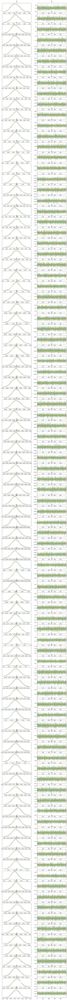

In [14]:
az.rcParams['plot.max_subplots'] = 2*(num_timepoints - R_t_start)

az.plot_trace(
    samples,
    var_names=('R'),
    filter_vars='like',
    compact=False)

In [15]:
# Eliminate burn-in iterations (1/2 of the chain lengths)
chain_samples = fit.draws()[500:, :, 7:]

# Evaluate the model for all parameter sets in the samples
n_param, n_sample, n_chains = chain_samples.shape

extended_samples = np.concatenate((
    chain_samples[:, 0, :],
    chain_samples[:, 1, :],
    chain_samples[:, 2, :]), axis=0)

thinning = max(1, int(n_sample * n_chains / 500))
approx_multicat_intervals = []

for j in range(num_categories):
    approx_multicat_intervals.append(pd.DataFrame({
        'Time Points': np.arange(R_t_start, num_timepoints),
        'Mean': np.mean(correc_i[j] * extended_samples[::thinning, :], axis=0),
        'Lower bound CI': np.quantile(correc_i[j] * extended_samples[::thinning, :], 0.025, axis=0),
        'Upper bound CI': np.quantile(correc_i[j] * extended_samples[::thinning, :], 0.975, axis=0),
        'Central Probability': (L1+L2+L3) * [0.95]
    }))

## 3. Imperfect Contact Tracing + Aggregated data + Poisson Branching process with multiple categories

In [16]:
agg_multicat_model = CmdStanModel(stan_file=os.path.join(
        '../../stan_models/agg_multicat.stan'))

agg_multicat_data = {
    'N': num_timepoints,
    'S': len(serial_interval),
    'n': num_categories,
    'C': contact_matrix,
    'transm': transmissibility,
    'I': agg_cases.astype(np.integer).tolist(),
    'tau': tau,
    'revSI': serial_interval.tolist()[::-1],
    'a': a,
    'b': b,
    'sigma': sigma}

/var/folders/ph/jyxnc9y52svgq2k5lt2q4r000000gp/T/ipykernel_1789/3052504579.py:10: DeprecationWarning:

Converting `np.integer` or `np.signedinteger` to a dtype is deprecated. The current result is `np.dtype(np.int_)` which is not strictly correct. Note that the result depends on the system. To ensure stable results use may want to use `np.int64` or `np.int32`.



In [17]:
fit = agg_multicat_model.sample(data=agg_multicat_data, seed=10, chains=3, iter_sampling=1000)

samples = az.from_cmdstanpy(fit)

az.summary(samples)

11:09:04 - cmdstanpy - INFO - CmdStan start processing
chain 1 |          | 00:00 Status
chain 1 |▍         | 00:00 Status
chain 1 |▉         | 25:56 Iteration:    1 / 2000 [  0%]  (Warmup)
chain 1 |█▊        | 29:51 Iteration:  200 / 2000 [ 10%]  (Warmup)
chain 1 |██▎       | 31:21 Iteration:  300 / 2000 [ 15%]  (Warmup)
chain 1 |██▋       | 33:02 Iteration:  400 / 2000 [ 20%]  (Warmup)
chain 1 |███▏      | 34:32 Iteration:  500 / 2000 [ 25%]  (Warmup)
chain 1 |████      | 37:07 Iteration:  700 / 2000 [ 35%]  (Warmup)
chain 1 |████▌     | 38:29 Iteration:  800 / 2000 [ 40%]  (Warmup)

chain 1 |█████▍    | 40:14 Iteration: 1000 / 2000 [ 50%]  (Warmup)
chain 1 |█████▉    | 42:02 Iteration: 1001 / 2000 [ 50%]  (Sampling)

chain 1 |██████▎   | 43:51 Iteration: 1100 / 2000 [ 55%]  (Sampling)
chain 1 |██████▊   | 45:38 Iteration: 1200 / 2000 [ 60%]  (Sampling)
chain 1 |███████▎  | 47:26 Iteration: 1300 / 2000 [ 65%]  (Sampling)
chain 1 |███████▋  | 49:10 Iteration: 1400 / 2000 [ 70%]  (Samp


12:08:59 - cmdstanpy - INFO - CmdStan done processing.
12:08:59 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'agg_multicat.stan', line 58, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'agg_multicat.stan', line 58, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'agg_multicat.stan', line 58, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'agg_multicat.stan', line 58, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'agg_multicat.stan', line 58, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'agg_multicat.stan', line 58, column 8 to column 28)
Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'agg_mult

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
R[0],0.500,0.041,0.425,0.575,0.001,0.000,6212.0,2146.0,1.0
R[1],0.512,0.037,0.445,0.584,0.000,0.000,6133.0,1941.0,1.0
R[2],0.439,0.030,0.382,0.494,0.000,0.000,5035.0,2234.0,1.0
R[3],0.505,0.029,0.449,0.560,0.000,0.000,4593.0,2322.0,1.0
R[4],0.465,0.026,0.416,0.515,0.000,0.000,4517.0,2128.0,1.0
...,...,...,...,...,...,...,...,...,...
"p[97, 1]",0.530,0.285,0.075,0.999,0.004,0.003,5807.0,1824.0,1.0
"p[98, 0]",0.496,0.291,0.013,0.954,0.003,0.003,8179.0,1696.0,1.0
"p[98, 1]",0.504,0.291,0.046,0.987,0.003,0.003,8179.0,1696.0,1.0
"p[99, 0]",0.502,0.285,0.064,0.998,0.003,0.003,7342.0,1637.0,1.0


array([[<Axes: title={'center': 'R\n0'}>,
        <Axes: title={'center': 'R\n0'}>],
       [<Axes: title={'center': 'R\n1'}>,
        <Axes: title={'center': 'R\n1'}>],
       [<Axes: title={'center': 'R\n2'}>,
        <Axes: title={'center': 'R\n2'}>],
       [<Axes: title={'center': 'R\n3'}>,
        <Axes: title={'center': 'R\n3'}>],
       [<Axes: title={'center': 'R\n4'}>,
        <Axes: title={'center': 'R\n4'}>],
       [<Axes: title={'center': 'R\n5'}>,
        <Axes: title={'center': 'R\n5'}>],
       [<Axes: title={'center': 'R\n6'}>,
        <Axes: title={'center': 'R\n6'}>],
       [<Axes: title={'center': 'R\n7'}>,
        <Axes: title={'center': 'R\n7'}>],
       [<Axes: title={'center': 'R\n8'}>,
        <Axes: title={'center': 'R\n8'}>],
       [<Axes: title={'center': 'R\n9'}>,
        <Axes: title={'center': 'R\n9'}>],
       [<Axes: title={'center': 'R\n10'}>,
        <Axes: title={'center': 'R\n10'}>],
       [<Axes: title={'center': 'R\n11'}>,
        <Axes: title

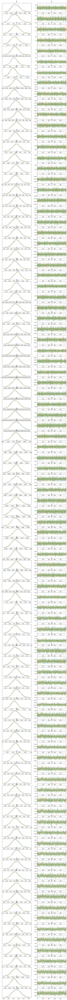

In [18]:
az.rcParams['plot.max_subplots'] = 2*(num_timepoints - R_t_start)

az.plot_trace(
    samples,
    var_names=('R'),
    filter_vars='like',
    compact=False)

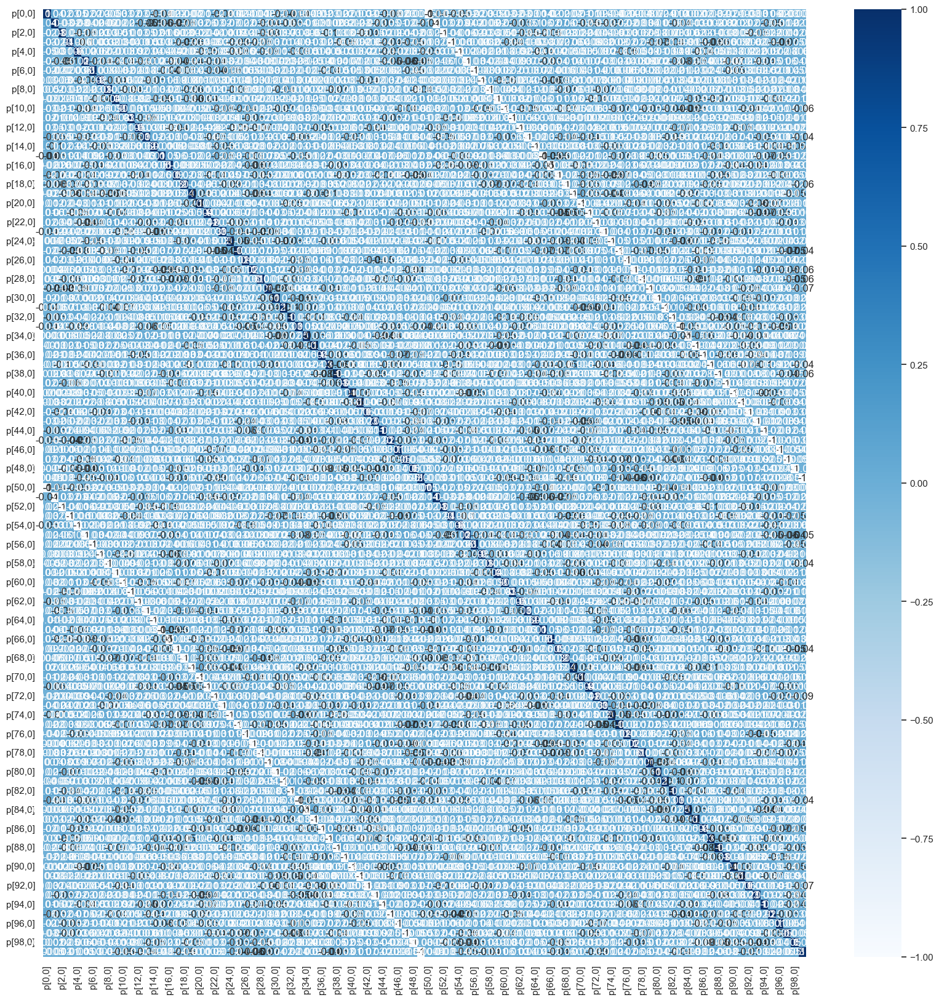

In [21]:
# Eliminate burn-in iterations (1/2 of the chain lengths)
p_chain_samples = fit.draws()[500:, :, (num_timepoints - R_t_start +7)::num_categories]

# Evaluate the model for all parameter sets in the samples
n_param, n_sample, n_chains = p_chain_samples.shape

extended_p_samples = np.concatenate((
    p_chain_samples[:, 0, :],
    p_chain_samples[:, 1, :],
    p_chain_samples[:, 2, :]), axis=0)

df = pd.DataFrame(
    extended_p_samples,
    columns=[
        'p[{},0]'.format(_)
        for _ in range(num_timepoints)])

plt.figure(figsize=(20,20))
sns.set_theme(style="white")
corr = df.corr()
heatmap = sns.heatmap(corr, annot=True, cmap="Blues", fmt='.1g')

In [22]:
# Eliminate burn-in iterations (1/2 of the chain lengths)
chain_samples = fit.draws()[500:, :, 7:(num_timepoints - R_t_start +7)]

# Evaluate the model for all parameter sets in the samples
n_param, n_sample, n_chains = chain_samples.shape

extended_samples = np.concatenate((
    chain_samples[:, 0, :],
    chain_samples[:, 1, :],
    chain_samples[:, 2, :]), axis=0)

thinning = max(1, int(n_sample * n_chains / 500))
agg_multicat_intervals = []

for j in range(num_categories):
    agg_multicat_intervals.append(pd.DataFrame({
        'Time Points': np.arange(R_t_start, num_timepoints),
        'Mean': np.mean(correc_i[j] * extended_samples[::thinning, :], axis=0),
        'Lower bound CI': np.quantile(correc_i[j] * extended_samples[::thinning, :], 0.025, axis=0),
        'Upper bound CI': np.quantile(correc_i[j] * extended_samples[::thinning, :], 0.975, axis=0),
        'Central Probability': (L1+L2+L3) * [0.95]
    }))

## 4. Aggregated data + Poisson Branching process

In [23]:
poisson_model = CmdStanModel(stan_file=os.path.join(
        '../../stan_models/poisson_one.stan'))

poisson_data = {
    'N': num_timepoints,
    'S': len(serial_interval),
    'I': agg_cases.astype(np.integer).tolist(),
    'tau': tau,
    'revSI': serial_interval.tolist()[::-1],
    'a': a,
    'b': b,
    'sigma': sigma}

/var/folders/ph/jyxnc9y52svgq2k5lt2q4r000000gp/T/ipykernel_1789/3414372969.py:7: DeprecationWarning:

Converting `np.integer` or `np.signedinteger` to a dtype is deprecated. The current result is `np.dtype(np.int_)` which is not strictly correct. Note that the result depends on the system. To ensure stable results use may want to use `np.int64` or `np.int32`.



In [24]:
fit = poisson_model.sample(
    data=poisson_data, seed=10, chains=3, iter_sampling=1000)

samples = az.from_cmdstanpy(fit)

az.summary(samples)

12:18:30 - cmdstanpy - INFO - CmdStan start processing
chain 1 |          | 00:00 Status

chain 1 |▉         | 00:01 Iteration:    1 / 2000 [  0%]  (Warmup)

chain 1 |█▎        | 00:02 Iteration:  100 / 2000 [  5%]  (Warmup)
chain 1 |█▊        | 00:03 Iteration:  200 / 2000 [ 10%]  (Warmup)
chain 1 |██▎       | 00:04 Iteration:  300 / 2000 [ 15%]  (Warmup)
chain 1 |██▋       | 00:05 Iteration:  400 / 2000 [ 20%]  (Warmup)
chain 1 |███▏      | 00:06 Iteration:  500 / 2000 [ 25%]  (Warmup)
chain 1 |███▋      | 00:07 Iteration:  600 / 2000 [ 30%]  (Warmup)
chain 1 |████      | 00:08 Iteration:  700 / 2000 [ 35%]  (Warmup)
chain 1 |████▌     | 00:08 Iteration:  800 / 2000 [ 40%]  (Warmup)
chain 1 |█████▉    | 00:10 Iteration: 1001 / 2000 [ 50%]  (Sampling)
chain 1 |██████▎   | 00:11 Iteration: 1100 / 2000 [ 55%]  (Sampling)
chain 1 |███████▎  | 00:12 Iteration: 1300 / 2000 [ 65%]  (Sampling)
chain 1 |████████▏ | 00:13 Iteration: 1500 / 2000 [ 75%]  (Sampling)
chain 1 |████████▋ | 00:14 Ite


12:18:49 - cmdstanpy - INFO - CmdStan done processing.
12:18:49 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: gamma_lpdf: Random variable is inf, but must be positive finite! (in 'poisson_one.stan', line 45, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is inf, but must be positive finite! (in 'poisson_one.stan', line 45, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'poisson_one.stan', line 45, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is inf, but must be positive finite! (in 'poisson_one.stan', line 45, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is inf, but must be positive finite! (in 'poisson_one.stan', line 45, column 8 to column 28)
Exception: gamma_lpdf: Random variable is inf, but must be positive finite! (in 'poisson_one.stan', line 45, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is inf, but must be positive finite! (in 'po

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
R[0],4.424,0.360,3.729,5.074,0.005,0.004,4329.0,1811.0,1.0
R[1],4.520,0.307,3.911,5.063,0.005,0.003,4149.0,2140.0,1.0
R[2],3.880,0.248,3.433,4.342,0.004,0.003,4114.0,1941.0,1.0
R[3],4.444,0.246,4.007,4.936,0.004,0.003,4439.0,2396.0,1.0
R[4],4.084,0.218,3.658,4.468,0.003,0.002,4176.0,2167.0,1.0
...,...,...,...,...,...,...,...,...,...
R[88],1.556,0.036,1.492,1.624,0.001,0.000,4363.0,2253.0,1.0
R[89],1.566,0.035,1.501,1.630,0.001,0.000,4130.0,2247.0,1.0
R[90],1.738,0.036,1.672,1.807,0.001,0.000,4094.0,2279.0,1.0
R[91],1.727,0.036,1.661,1.795,0.001,0.000,3497.0,2276.0,1.0


array([[<Axes: title={'center': 'R\n0'}>,
        <Axes: title={'center': 'R\n0'}>],
       [<Axes: title={'center': 'R\n1'}>,
        <Axes: title={'center': 'R\n1'}>],
       [<Axes: title={'center': 'R\n2'}>,
        <Axes: title={'center': 'R\n2'}>],
       [<Axes: title={'center': 'R\n3'}>,
        <Axes: title={'center': 'R\n3'}>],
       [<Axes: title={'center': 'R\n4'}>,
        <Axes: title={'center': 'R\n4'}>],
       [<Axes: title={'center': 'R\n5'}>,
        <Axes: title={'center': 'R\n5'}>],
       [<Axes: title={'center': 'R\n6'}>,
        <Axes: title={'center': 'R\n6'}>],
       [<Axes: title={'center': 'R\n7'}>,
        <Axes: title={'center': 'R\n7'}>],
       [<Axes: title={'center': 'R\n8'}>,
        <Axes: title={'center': 'R\n8'}>],
       [<Axes: title={'center': 'R\n9'}>,
        <Axes: title={'center': 'R\n9'}>],
       [<Axes: title={'center': 'R\n10'}>,
        <Axes: title={'center': 'R\n10'}>],
       [<Axes: title={'center': 'R\n11'}>,
        <Axes: title

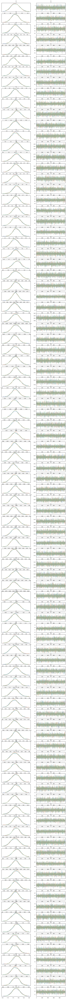

In [25]:
az.rcParams['plot.max_subplots'] = 2*(num_timepoints - R_t_start)

az.plot_trace(
    samples,
    var_names=('R'),
    filter_vars='like',
    compact=False)

In [26]:
# Eliminate burn-in iterations (1/2 of the chain lengths)
chain_samples = fit.draws()[500:, :, 7:]

# Evaluate the model for all parameter sets in the samples
n_param, n_sample, n_chains = chain_samples.shape

extended_samples = np.concatenate((
    chain_samples[:, 0, :],
    chain_samples[:, 1, :],
    chain_samples[:, 2, :]), axis=0)

thinning = max(1, int(n_sample * n_chains / 500))

pois_intervals = pd.DataFrame({
    'Time Points': np.arange(R_t_start, num_timepoints),
    'Mean': np.mean(extended_samples[::thinning, :], axis=0),
    'Lower bound CI': np.quantile(extended_samples[::thinning, :], 0.025, axis=0),
    'Upper bound CI': np.quantile(extended_samples[::thinning, :], 0.975, axis=0),
    'Central Probability': (L1+L2+L3) * [0.95]
})

## Inference plot using class method results

In [27]:
fig = ReproductionNumberPlot()

for j in range(num_categories):
    fig.add_ground_truth_rt(ground_truth[j])
    fig.add_interval_rt(exact_multicat_intervals[j], model_type='Category {} Perfect Contact Data'.format(j+1))
    fig.add_interval_rt(approx_multicat_intervals[j], colour='red', model_type='Category {} Desggregate + Limited Contact Data'.format(j+1))
    fig.add_interval_rt(agg_multicat_intervals[j], colour='orange', model_type='Category {} Aggregate + Limited Contact Data'.format(j+1))
fig.add_interval_rt(pois_intervals, colour='deepskyblue', model_type='1-category Poisson')
   
fig.update_labels(time_label='Time (Day)', r_label='R_t')

fig.figure.add_hline(
    y=1, line_dash='dot',
    annotation_text='R<sub>t</sub>=1', fillcolor='black',
    annotation_position='top left')

fig.figure.update_layout(
    width=900, 
    height=700,
    plot_bgcolor='white',
    font=dict(
            size=16),
    xaxis=dict(
        linecolor='black'),
    yaxis=dict(
        linecolor='black'),
    legend=dict(
            orientation="h",
            yanchor="bottom",
            y=0.9,
            xanchor="right",
            x=1.05,
            bordercolor="Black",
            borderwidth=1
        )
)

fig.figure.write_image('images/Figure 2.pdf')

fig.show_figure()

/Users/ioaros/Desktop/Software Project/branchpro/branchpro/apps/_reproduction_number_plot.py:27: UserWarning:

Labels do not match. They will be updated.



In [28]:
fig = ReproductionNumberPlot()

j=0
fig.add_ground_truth_rt(ground_truth[j])
fig.figure.data[0]['name'] = 'True R<sup>({})</sup><sub>t</sub>'.format(j+1)

fig.add_interval_rt(approx_multicat_intervals[j], colour='red', model_type='<sup>({})</sup><sub>t</sub> Disaggregated + Limited Contact Data Multiple Group Model'.format(j+1))
fig.figure.data[1]['name'] = 'Estimated R<sup>({})</sup><sub>t</sub> Disaggregated + Limited Contact Data Multiple Group Model'.format(j+1)

fig.add_interval_rt(agg_multicat_intervals[j], colour='orange', model_type='<sup>({})</sup><sub>t</sub> Aggregated + Limited Contact Data Multiple Group Model'.format(j+1))
fig.figure.data[3]['name'] = 'Estimated R<sup>({})</sup><sub>t</sub> Aggregated + Limited Contact Data Multiple Group Model'.format(j+1)

fig.add_interval_rt(pois_intervals, colour='deepskyblue', model_type='One Group Model')
fig.figure.data[5]['name'] = 'Estimated R<sub>t</sub> One Group Model'
   
fig.update_labels(time_label='Time (days)', r_label='Reproduction number R<sub>t</sub>')

for i in range(3):
        fig.figure['data'][2*(i+1)]['showlegend'] = False

fig.figure.add_hline(
    y=1, line_dash='dot',
    annotation_text='R<sub>t</sub>=1', fillcolor='black',
    annotation_position='top left')

fig.figure.update_layout(
    width=900, 
    height=600,
    plot_bgcolor='white',
    font=dict(
            size=16),
    xaxis=dict(
        linecolor='black'),
    yaxis=dict(
        linecolor='black'),
    legend=dict(
            orientation="h",
            yanchor="bottom",
            y=0.8,
            xanchor="right",
            x=1.1,
            bordercolor="Black",
            borderwidth=1
        )
)

fig.figure.write_image('images/Figure 3.pdf')

fig.show_figure()

In [29]:
fig = ReproductionNumberPlot()

j=0
fig.add_ground_truth_rt(ground_truth[j])
fig.figure.data[0]['name'] = 'True R<sup>({})</sup><sub>t</sub>'.format(j+1)

fig.add_interval_rt(exact_multicat_intervals[j], colour='mediumvioletred', model_type='<sup>({})</sup><sub>t</sub> Perfect Contact Data Multiple Group Model'.format(j+1))
fig.figure.data[1]['name'] = 'Estimated R<sup>({})</sup><sub>t</sub> Perfect Contact Data Multiple Group Model'.format(j+1)

fig.add_interval_rt(pois_intervals, colour='deepskyblue', model_type='One Group Model')
fig.figure.data[3]['name'] = 'Estimated R<sub>t</sub> One Group Model'
   
fig.update_labels(time_label='Time (days)', r_label='Reproduction number R<sub>t</sub>')

for i in range(2):
        fig.figure['data'][2*(i+1)]['showlegend'] = False

fig.figure.add_hline(
    y=1, line_dash='dot',
    annotation_text='R<sub>t</sub>=1', fillcolor='black',
    annotation_position='top left')

fig.figure.update_layout(
    width=900, 
    height=600,
    plot_bgcolor='white',
    font=dict(
            size=16),
    xaxis=dict(
        linecolor='black'),
    yaxis=dict(
        linecolor='black'),
    legend=dict(
            orientation="h",
            yanchor="bottom",
            y=0.8,
            xanchor="right",
            x=1.05,
            bordercolor="Black",
            borderwidth=1
        )
)

fig.figure.write_image('images/Figure 3 Perfect.pdf')

fig.show_figure()

In [30]:
fig = ReproductionNumberPlot()

j=1
fig.add_ground_truth_rt(ground_truth[j])
fig.figure.data[0]['name'] = 'True R<sup>({})</sup><sub>t</sub>'.format(j+1)

fig.add_interval_rt(approx_multicat_intervals[j], colour='red', model_type='<sup>({})</sup><sub>t</sub> Disaggregated + Limited Contact Data Multiple Group Model'.format(j+1))
fig.figure.data[1]['name'] = 'Estimated R<sup>({})</sup><sub>t</sub> Disaggregated + Limited Contact Data Multiple Group Model'.format(j+1)

fig.add_interval_rt(agg_multicat_intervals[j], colour='orange', model_type='<sup>({})</sup><sub>t</sub> Aggregated + Limited Contact Data Multiple Group Model'.format(j+1))
fig.figure.data[3]['name'] = 'Estimated R<sup>({})</sup><sub>t</sub> Aggregated + Limited Contact Data Multiple Group Model'.format(j+1)

fig.add_interval_rt(pois_intervals, colour='deepskyblue', model_type='One Group Model')
fig.figure.data[5]['name'] = 'Estimated R<sub>t</sub> One Group Model'

fig.update_labels(time_label='Time (days)', r_label='Reproduction number R<sub>t</sub>')

for i in range(3):
        fig.figure['data'][2*(i+1)]['showlegend'] = False

fig.figure.add_hline(
    y=1, line_dash='dot',
    annotation_text='R<sub>t</sub>=1', fillcolor='black',
    annotation_position='top left')

fig.figure.update_layout(
    width=900, 
    height=600,
    plot_bgcolor='white',
    font=dict(
            size=16),
    xaxis=dict(
        linecolor='black'),
    yaxis=dict(
        linecolor='black'),
    legend=dict(
            orientation="h",
            yanchor="bottom",
            y=0.8,
            xanchor="right",
            x=1.05,
            bordercolor="Black",
            borderwidth=1
        )
)

fig.figure.write_image('images/Figure 4.pdf')

fig.show_figure()

In [31]:
fig = ReproductionNumberPlot()

j=1
fig.add_ground_truth_rt(ground_truth[j])
fig.figure.data[0]['name'] = 'True R<sup>({})</sup><sub>t</sub>'.format(j+1)

fig.add_interval_rt(exact_multicat_intervals[j], colour='mediumvioletred', model_type='<sup>({})</sup><sub>t</sub> Perfect Contact Data Multiple Group Model'.format(j+1))
fig.figure.data[1]['name'] = 'Estimated R<sup>({})</sup><sub>t</sub> Perfect Contact Data Multiple Group Model'.format(j+1)

fig.add_interval_rt(pois_intervals, colour='deepskyblue', model_type='One Group Model')
fig.figure.data[3]['name'] = 'Estimated R<sub>t</sub> One Group Model'

fig.update_labels(time_label='Time (days)', r_label='Reproduction number R<sub>t</sub>')

for i in range(2):
        fig.figure['data'][2*(i+1)]['showlegend'] = False

fig.figure.add_hline(
    y=1, line_dash='dot',
    annotation_text='R<sub>t</sub>=1', fillcolor='black',
    annotation_position='top left')

fig.figure.update_layout(
    width=900, 
    height=600,
    plot_bgcolor='white',
    font=dict(
            size=16),
    xaxis=dict(
        linecolor='black'),
    yaxis=dict(
        linecolor='black'),
    legend=dict(
            orientation="h",
            yanchor="bottom",
            y=0.8,
            xanchor="right",
            x=1.05,
            bordercolor="Black",
            borderwidth=1
        )
)

fig.figure.write_image('images/Figure 4 Perfect.pdf')

fig.show_figure()